# Object Detection API Demo via Tensorflow2 object detection api

In [1]:
import tensorflow as tf
print("GPU Available: ", tf.test.is_gpu_available())

print("Tensorflow Version: ", tf.__version__)
print("Keras Version: ", tf.keras.__version__)

#check GPU
physical_devices = tf.config.experimental.list_physical_devices('GPU')
print(physical_devices)

2022-07-13 10:02:05.232453: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.
GPU Available:  True
Tensorflow Version:  2.9.1
Keras Version:  2.9.0
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:2', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:3', device_type='GPU')]


2022-07-13 10:02:07.046963: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-07-13 10:02:08.685463: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1532] Created device /device:GPU:0 with 38418 MB memory:  -> device: 0, name: NVIDIA A100-PCIE-40GB, pci bus id: 0000:17:00.0, compute capability: 8.0
2022-07-13 10:02:08.686100: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1532] Created device /device:GPU:1 with 38418 MB memory:  -> device: 1, name: NVIDIA A100-PCIE-40GB, pci bus id: 0000:65:00.0, compute capability: 8.0
2022-07-13 10:02:08.686601: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1532] Created device /device:GPU:2 with 38418 MB memory:  -> device: 2, name: NVIDIA A100-PCIE-40GB

In [2]:
!nvidia-smi

Wed Jul 13 10:02:14 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.39.01    Driver Version: 510.39.01    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-PCI...  On   | 00000000:17:00.0 Off |                    0 |
| N/A   32C    P0    37W / 250W |    582MiB / 40960MiB |      0%   E. Process |
|                               |                      |             Enabled* |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA A100-PCI...  On   | 00000000:65:00.0 Off |                    0 |
| N/A   

# Object Detection API Installation

Ref: https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2.md

In [3]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 2250, done.
remote: Counting objects: 100% (2250/2250), done.
remote: Compressing objects: 100% (1947/1947), done.
remote: Total 2250 (delta 550), reused 956 (delta 277), pack-reused 0
Receiving objects: 100% (2250/2250), 30.51 MiB | 18.20 MiB/s, done.
Resolving deltas: 100% (550/550), done.


In [4]:
!protoc --version

libprotoc 3.0.0


In [5]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-cp36-none-any.whl size=1581844 sha256=d1faeb60e03fdba0e6acffd544005882fc41dd6443f1d44e9df76566e3aeff39
  Stored in directory: /tmp/pip-ephem-wheel-cache-qzxxmwin/wheels/94/49/4b/39b051683087a22ef7e80ec52152a27249d1a644ccf4e442ea
  Created wheel for avro-python3: filename=avro_python3-1.10.0-cp36-none-any.whl size=43735 sha256=956744e1e1e4ef5cb71ac9da87a3a35ed283faa359c32e94b4171bc2285c488d
  Stored in directory: /root/.cache/pip/wheels/3f/15/cd/fe4ec8b88c130393464703ee8111e2cddebdc40e1b59ea85e9
  Created wheel for hdfs: filename=hdfs-2.5.8-cp36-none-any.whl size=33213 sha256=7517fbdd6662e746dcf9731aa1eaf19eaf7e146ded4efa680ce642318a28334b
  Stored in directory: /root/.cache/pip/wheels/fe/a7/05/23e3699975fc20f8a30e00ac1e515ab8c61168e982abe4ce70
  Created wheel for dill: filename=dill-0.3.1.1-cp36-none-any.whl size=78532 sha256=4159bdc9e3419605e2f01979402dda7c1fdffb8903a02e224d3750cb95

ERROR: pydrive 1.3.1 has requirement oauth2client>=4.0.0, but you'll have oauth2client 3.0.0 which is incompatible.
ERROR: multiprocess 0.70.10 has requirement dill>=0.3.2, but you'll have dill 0.3.1.1 which is incompatible.
ERROR: google-colab 1.0.0 has requirement requests~=2.23.0, but you'll have requests 2.24.0 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: apache-beam 2.24.0 has requirement avro-python3!=1.9.2,<1.10.0,>=1.8.1; python_version >= "3.0", but you'll have avro-python3 1.10.0 which is incompatible.


In [6]:
!python ./models/research/object_detection/builders/model_builder_tf2_test.py

2020-10-20 18:15:32.214526: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Running tests under Python 3.6.9: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2020-10-20 18:15:34.614570: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-10-20 18:15:34.620364: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-10-20 18:15:34.620999: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 15.75GiB deviceMemoryBandwidth: 836.37GiB/s
2020-10-20 18:15:34.621036: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Su

In [7]:
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder


%matplotlib inline

# Inference
ref: https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/inference_tf2_colab.ipynb

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def get_keypoint_tuples(eval_config):
  """Return a tuple list of keypoint edges from the eval config.
  
  Args:
    eval_config: an eval config containing the keypoint edges
  
  Returns:
    a list of edge tuples, each in the format (start, end)
  """
  tuple_list = []
  kp_list = eval_config.keypoint_edge
  for edge in kp_list:
    tuple_list.append((edge.start, edge.end))
  return tuple_list

In [ ]:
# @title Choose the model to use, then evaluate the cell.
MODELS = {'centernet_with_keypoints': 'centernet_hg104_512x512_kpts_coco17_tpu-32', 'centernet_without_keypoints': 'centernet_hg104_512x512_coco17_tpu-8'}

model_display_name = 'centernet_without_keypoints' # @param ['centernet_with_keypoints', 'centernet_without_keypoints']
model_name = MODELS[model_display_name]

In [ ]:
# Download the checkpoint and put it into models/research/object_detection/test_data/

if model_display_name == 'centernet_with_keypoints':
  !wget http://download.tensorflow.org/models/object_detection/tf2/20200711/centernet_hg104_512x512_kpts_coco17_tpu-32.tar.gz
  !tar -xf centernet_hg104_512x512_kpts_coco17_tpu-32.tar.gz
  !mv centernet_hg104_512x512_kpts_coco17_tpu-32/checkpoint models/research/object_detection/test_data/
else:
  !wget http://download.tensorflow.org/models/object_detection/tf2/20200711/centernet_hg104_512x512_coco17_tpu-8.tar.gz
  !tar -xf centernet_hg104_512x512_coco17_tpu-8.tar.gz
  !mv centernet_hg104_512x512_coco17_tpu-8/checkpoint models/research/object_detection/test_data/

--2020-09-20 22:36:12--  http://download.tensorflow.org/models/object_detection/tf2/20200711/centernet_hg104_512x512_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 108.177.125.128, 2404:6800:4008:c01::80
Connecting to download.tensorflow.org (download.tensorflow.org)|108.177.125.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1426100886 (1.3G) [application/x-tar]
Saving to: ‘centernet_hg104_512x512_coco17_tpu-8.tar.gz’

centernet_hg104_512 100%[===================>]   1.33G  74.5MB/s    in 19s     

2020-09-20 22:36:31 (71.2 MB/s) - ‘centernet_hg104_512x512_coco17_tpu-8.tar.gz’ saved [1426100886/1426100886]



In [ ]:
model_name

'centernet_hg104_512x512_coco17_tpu-8'

In [ ]:
!ls models/research/object_detection/test_data/

checkpoint			 snapshot_serengeti_sequence_examples.record
context_rcnn_camera_trap.config  ssd_mobilenet_v1_fpp.config
pets_examples.record


In [ ]:
!pwd

/content


In [ ]:
!ls

centernet_hg104_512x512_coco17_tpu-8	     models
centernet_hg104_512x512_coco17_tpu-8.tar.gz  sample_data


In [ ]:
# pipeline_config = os.path.join('models/research/object_detection/configs/tf2/',
#                                 'center_net_hourglass104_512x512_coco17_tpu-8' + '.config')
pipeline_config = os.path.join('./centernet_hg104_512x512_coco17_tpu-8/' + 'pipeline.config')
model_dir = 'models/research/object_detection/test_data/checkpoint/'

# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join(model_dir, 'ckpt-0')).expect_partial()

def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

In [ ]:
pipeline_config

'./centernet_hg104_512x512_coco17_tpu-8/pipeline.config'

In [ ]:
!cp models/research/object_detection/configs/tf2/center_net_hourglass104_512x512_coco17_tpu-8.config .

In [ ]:
label_map_path = configs['eval_input_config'].label_map_path
label_map_path

'PATH_TO_BE_CONFIGURED/label_map.txt'

In [ ]:
label_map_path='/content/models/research/object_detection/data/mscoco_label_map.pbtxt'

In [ ]:
label_map = label_map_util.load_labelmap(label_map_path)
label_map

item {
  name: "/m/01g317"
  id: 1
  display_name: "person"
}
item {
  name: "/m/0199g"
  id: 2
  display_name: "bicycle"
}
item {
  name: "/m/0k4j"
  id: 3
  display_name: "car"
}
item {
  name: "/m/04_sv"
  id: 4
  display_name: "motorcycle"
}
item {
  name: "/m/05czz6l"
  id: 5
  display_name: "airplane"
}
item {
  name: "/m/01bjv"
  id: 6
  display_name: "bus"
}
item {
  name: "/m/07jdr"
  id: 7
  display_name: "train"
}
item {
  name: "/m/07r04"
  id: 8
  display_name: "truck"
}
item {
  name: "/m/019jd"
  id: 9
  display_name: "boat"
}
item {
  name: "/m/015qff"
  id: 10
  display_name: "traffic light"
}
item {
  name: "/m/01pns0"
  id: 11
  display_name: "fire hydrant"
}
item {
  name: "/m/02pv19"
  id: 13
  display_name: "stop sign"
}
item {
  name: "/m/015qbp"
  id: 14
  display_name: "parking meter"
}
item {
  name: "/m/0cvnqh"
  id: 15
  display_name: "bench"
}
item {
  name: "/m/015p6"
  id: 16
  display_name: "bird"
}
item {
  name: "/m/01yrx"
  id: 17
  display_name: "cat

In [ ]:
#label_map_path = configs['eval_input_config'].label_map_path
#label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

In [ ]:
label_map_dict

{'airplane': 5,
 'apple': 53,
 'backpack': 27,
 'banana': 52,
 'baseball bat': 39,
 'baseball glove': 40,
 'bear': 23,
 'bed': 65,
 'bench': 15,
 'bicycle': 2,
 'bird': 16,
 'boat': 9,
 'book': 84,
 'bottle': 44,
 'bowl': 51,
 'broccoli': 56,
 'bus': 6,
 'cake': 61,
 'car': 3,
 'carrot': 57,
 'cat': 17,
 'cell phone': 77,
 'chair': 62,
 'clock': 85,
 'couch': 63,
 'cow': 21,
 'cup': 47,
 'dining table': 67,
 'dog': 18,
 'donut': 60,
 'elephant': 22,
 'fire hydrant': 11,
 'fork': 48,
 'frisbee': 34,
 'giraffe': 25,
 'hair drier': 89,
 'handbag': 31,
 'horse': 19,
 'hot dog': 58,
 'keyboard': 76,
 'kite': 38,
 'knife': 49,
 'laptop': 73,
 'microwave': 78,
 'motorcycle': 4,
 'mouse': 74,
 'orange': 55,
 'oven': 79,
 'parking meter': 14,
 'person': 1,
 'pizza': 59,
 'potted plant': 64,
 'refrigerator': 82,
 'remote': 75,
 'sandwich': 54,
 'scissors': 87,
 'sheep': 20,
 'sink': 81,
 'skateboard': 41,
 'skis': 35,
 'snowboard': 36,
 'spoon': 50,
 'sports ball': 37,
 'stop sign': 13,
 'suitca

Instructions for updating:
Use `tf.cast` instead.


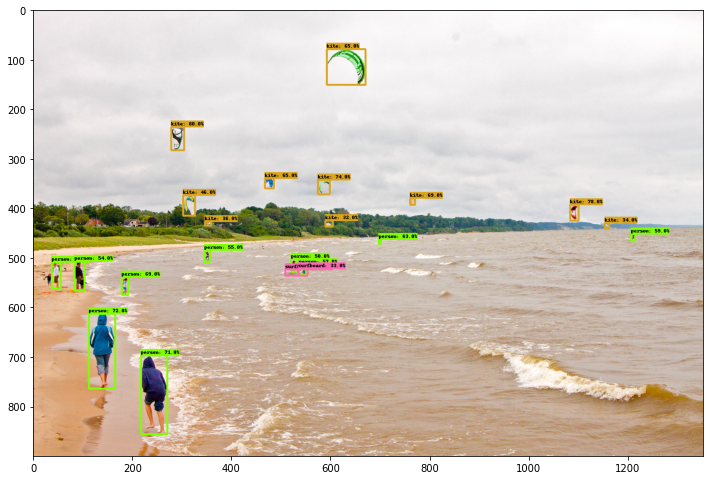

In [ ]:
image_dir = 'models/research/object_detection/test_images/'
image_path = os.path.join(image_dir, 'image2.jpg')
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

# Use keypoints if available in detections
keypoints, keypoint_scores = None, None
if 'detection_keypoints' in detections:
  keypoints = detections['detection_keypoints'][0].numpy()
  keypoint_scores = detections['detection_keypoint_scores'][0].numpy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.30,
      agnostic_mode=False,
      keypoints=keypoints,
      keypoint_scores=keypoint_scores,
      keypoint_edges=get_keypoint_tuples(configs['eval_config']))

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

In [ ]:
detections['detection_boxes'][0] #get the first batch, only one batch

<tf.Tensor: shape=(100, 4), dtype=float32, numpy=
array([[0.26331702, 0.20630795, 0.3134004 , 0.2257505 ],
       [0.43730366, 0.80151385, 0.4719698 , 0.8148971 ],
       [0.38156968, 0.42489603, 0.41272268, 0.44364318],
       [0.681903  , 0.08294669, 0.84796304, 0.12350222],
       [0.77523005, 0.16085468, 0.95053935, 0.2007731 ],
       [0.5992846 , 0.13199385, 0.6379219 , 0.1426181 ],
       [0.42316636, 0.5627608 , 0.43578175, 0.5702687 ],
       [0.08820905, 0.437933  , 0.16722633, 0.49660912],
       [0.3785455 , 0.34565732, 0.39969328, 0.3596621 ],
       [0.5662745 , 0.02796838, 0.62555325, 0.04213667],
       [0.5147716 , 0.5157676 , 0.5233711 , 0.5195452 ],
       [0.50261086, 0.8926434 , 0.51683396, 0.89914817],
       [0.5714626 , 0.39679745, 0.5932119 , 0.40797928],
       [0.5398747 , 0.25573713, 0.5655136 , 0.26418972],
       [0.5638006 , 0.06161625, 0.6279921 , 0.07694124],
       [0.55976266, 0.38481852, 0.58640236, 0.394439  ],
       [0.41595435, 0.22352442, 0.4608

In [ ]:
detections['detection_classes'][0]

<tf.Tensor: shape=(100,), dtype=int32, numpy=
array([37, 37, 37,  0,  0,  0, 37, 37, 37,  0,  0,  0,  0,  0,  0,  0, 37,
       41, 37, 37, 41, 37, 37, 41,  0,  0, 37,  0, 30, 37,  0,  0,  0,  0,
       39, 37,  0, 30, 17, 41, 26,  0,  0, 41,  0,  0, 37, 37, 26, 36,  0,
       37,  0, 37,  0,  0, 30, 17,  0, 36, 41, 37,  0, 37,  0,  0, 37, 37,
        0, 27,  0,  0, 37, 37, 42, 37,  0, 41, 37, 33, 37,  2, 37,  0, 36,
        8,  0, 27,  0, 18,  0, 41, 37,  0,  0, 37, 37,  0, 37,  0],
      dtype=int32)>

In [ ]:
detections['detection_scores'][0]

<tf.Tensor: shape=(100,), dtype=float32, numpy=
array([0.7962751 , 0.78206927, 0.7410706 , 0.7218724 , 0.70915806,
       0.6893627 , 0.6872321 , 0.6508865 , 0.64793307, 0.64436376,
       0.6263485 , 0.5901032 , 0.5733943 , 0.5519157 , 0.5434328 ,
       0.49587497, 0.4632389 , 0.42329958, 0.35777912, 0.34114274,
       0.328882  , 0.32425722, 0.2495297 , 0.24379438, 0.22302711,
       0.19288327, 0.18518162, 0.1585301 , 0.15249111, 0.1416736 ,
       0.14132652, 0.13689676, 0.13375592, 0.12325503, 0.11930388,
       0.11783273, 0.11717883, 0.11705264, 0.11549332, 0.11444061,
       0.11316915, 0.10898951, 0.10370461, 0.09707274, 0.09699165,
       0.09487169, 0.08954646, 0.08784059, 0.08563183, 0.08429349,
       0.08406363, 0.08199514, 0.08186882, 0.08139408, 0.08128863,
       0.07760189, 0.07508621, 0.07300808, 0.07214538, 0.07115618,
       0.07113731, 0.06998829, 0.06737442, 0.06533942, 0.0637641 ,
       0.06343437, 0.06288642, 0.06269628, 0.06261943, 0.06232625,
       0.06188

# Custom Inference via checkpoint

In [8]:
!wget https://cdn.pixabay.com/photo/2013/07/05/01/08/traffic-143391_960_720.jpg -O traffic.jpg

--2020-10-20 18:16:43--  https://cdn.pixabay.com/photo/2013/07/05/01/08/traffic-143391_960_720.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 104.18.21.183, 104.18.20.183, 2606:4700::6812:15b7, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|104.18.21.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 253264 (247K) [image/jpeg]
Saving to: ‘traffic.jpg’

traffic.jpg         100%[===================>] 247.33K  --.-KB/s    in 0.1s    

2020-10-20 18:16:44 (2.49 MB/s) - ‘traffic.jpg’ saved [253264/253264]



In [9]:
def show_inference(detection_model, image_path):
  #image_np = load_image_into_numpy_array(image_path)
  img_data = tf.io.gfile.GFile(image_path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  image_np = np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

  input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
  detect_fn = get_model_detection_function(detection_model)
  detections, predictions_dict, shapes = detect_fn(input_tensor)
  detectionboxes = detections['detection_boxes'][0].numpy()
  detectionscores = detections['detection_scores'][0].numpy()
  detectionclasses = detections['detection_classes'][0].numpy()
  
  label_id_offset = 1
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np,
      detectionboxes,
      (detectionclasses + label_id_offset).astype(int),
      detectionscores,
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.30,
      agnostic_mode=False)

  plt.figure(figsize=(12,16))
  plt.imshow(image_np)
  plt.show()

In [10]:
label_map_path='/content/models/research/object_detection/data/mscoco_label_map.pbtxt'
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

In [11]:
category_index

{1: {'id': 1, 'name': 'person'},
 2: {'id': 2, 'name': 'bicycle'},
 3: {'id': 3, 'name': 'car'},
 4: {'id': 4, 'name': 'motorcycle'},
 5: {'id': 5, 'name': 'airplane'},
 6: {'id': 6, 'name': 'bus'},
 7: {'id': 7, 'name': 'train'},
 8: {'id': 8, 'name': 'truck'},
 9: {'id': 9, 'name': 'boat'},
 10: {'id': 10, 'name': 'traffic light'},
 11: {'id': 11, 'name': 'fire hydrant'},
 13: {'id': 13, 'name': 'stop sign'},
 14: {'id': 14, 'name': 'parking meter'},
 15: {'id': 15, 'name': 'bench'},
 16: {'id': 16, 'name': 'bird'},
 17: {'id': 17, 'name': 'cat'},
 18: {'id': 18, 'name': 'dog'},
 19: {'id': 19, 'name': 'horse'},
 20: {'id': 20, 'name': 'sheep'},
 21: {'id': 21, 'name': 'cow'},
 22: {'id': 22, 'name': 'elephant'},
 23: {'id': 23, 'name': 'bear'},
 24: {'id': 24, 'name': 'zebra'},
 25: {'id': 25, 'name': 'giraffe'},
 27: {'id': 27, 'name': 'backpack'},
 28: {'id': 28, 'name': 'umbrella'},
 31: {'id': 31, 'name': 'handbag'},
 32: {'id': 32, 'name': 'tie'},
 33: {'id': 33, 'name': 'suitc

In [12]:
#!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/centernet_hg104_1024x1024_coco17_tpu-32.tar.gz
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
#https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md

--2020-10-20 18:16:57--  http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.143.128, 2a00:1450:4013:c05::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.143.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 211996178 (202M) [application/x-tar]
Saving to: ‘faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz’

faster_rcnn_resnet5 100%[===================>] 202.17M  56.9MB/s    in 3.6s    

2020-10-20 18:17:03 (56.9 MB/s) - ‘faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz’ saved [211996178/211996178]



In [13]:
!ls

faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz  sample_data
models						     traffic.jpg


In [14]:
!tar -xf faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
#!tar -xf centernet_hg104_1024x1024_coco17_tpu-32.tar.gz
#!mv centernet_hg104_512x512_kpts_coco17_tpu-32/checkpoint models/research/object_detection/test_data/

In [15]:
!ls

faster_rcnn_resnet50_v1_640x640_coco17_tpu-8	     models	  traffic.jpg
faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz  sample_data


In [16]:
def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

INFO:tensorflow:depth of additional conv before box predictor: 0
Instructions for updating:
Use ref() instead.


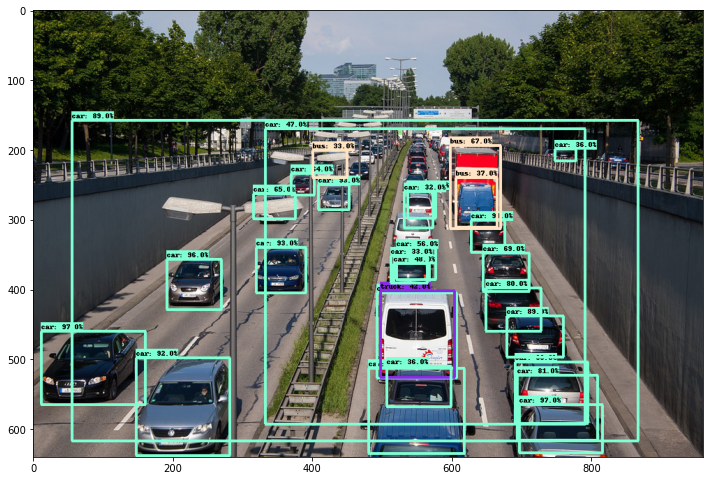

In [17]:
# pipeline_config = './centernet_hg104_1024x1024_coco17_tpu-32/pipeline.config'
# model_dir = './centernet_hg104_1024x1024_coco17_tpu-32/checkpoint'
pipeline_config = './faster_rcnn_resnet50_v1_640x640_coco17_tpu-8/pipeline.config'
model_dir = './faster_rcnn_resnet50_v1_640x640_coco17_tpu-8/checkpoint'

# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join(model_dir, 'ckpt-0')).expect_partial()

show_inference(detection_model, 'traffic.jpg')

# Custom Inference via Saved model

In [18]:
import time
start_time = time.time()
tf.keras.backend.clear_session()
detect_fn = tf.saved_model.load('./faster_rcnn_resnet50_v1_640x640_coco17_tpu-8/saved_model/')
end_time = time.time()
elapsed_time = end_time - start_time
print('Elapsed time: ' + str(elapsed_time) + 's')

Elapsed time: 9.011334657669067s


In [20]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

Elapsed time: 1.6225850582122803 second per image


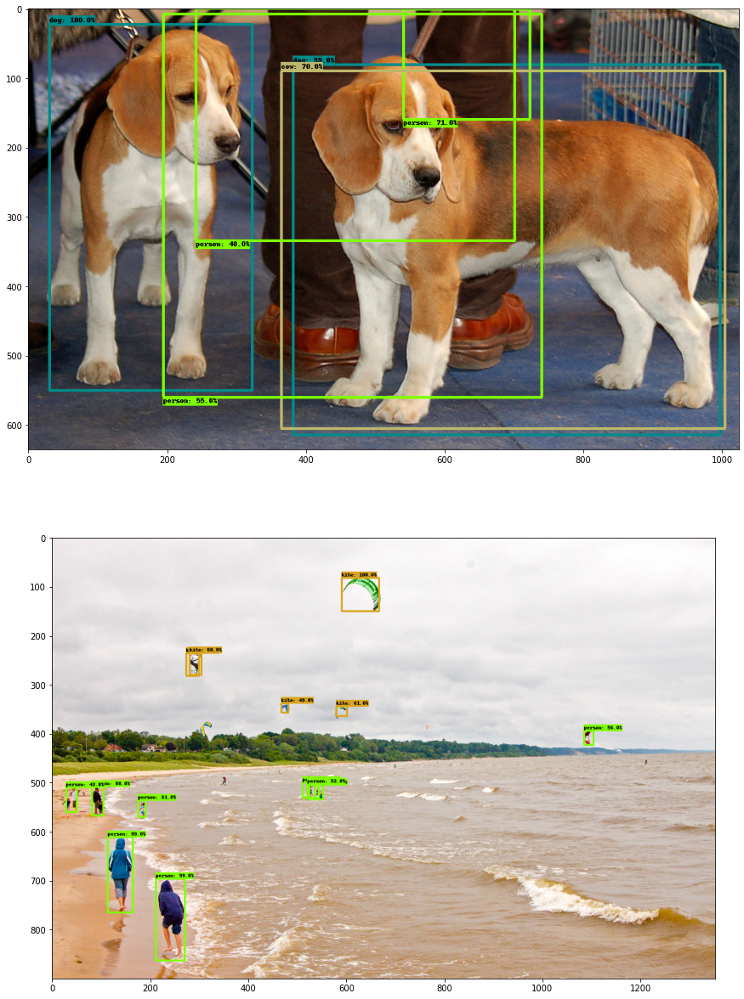

In [21]:

import time

image_dir = './models/research/object_detection/test_images'

elapsed = []
for i in range(2):
  image_path = os.path.join(image_dir, 'image' + str(i + 1) + '.jpg')
  image_np = load_image_into_numpy_array(image_path)
  input_tensor = np.expand_dims(image_np, 0)
  start_time = time.time()
  detections = detect_fn(input_tensor)
  end_time = time.time()
  elapsed.append(end_time - start_time)

  plt.rcParams['figure.figsize'] = [42, 21]
  label_id_offset = 1
  image_np_with_detections = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'][0].numpy(),
        detections['detection_classes'][0].numpy().astype(np.int32),
        detections['detection_scores'][0].numpy(),
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=.40,
        agnostic_mode=False)
  plt.subplot(2, 1, i+1)
  plt.imshow(image_np_with_detections)

mean_elapsed = sum(elapsed) / float(len(elapsed))
print('Elapsed time: ' + str(mean_elapsed) + ' second per image')

In [22]:
print(detect_fn.signatures['serving_default'].inputs)

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_14:0' shape=<unknown> dtype=resource>, <

In [23]:
detect_fn.signatures['serving_default'].output_shapes

{'detection_anchor_indices': TensorShape([1, 300]),
 'detection_boxes': TensorShape([1, 300, 4]),
 'detection_classes': TensorShape([1, 300]),
 'detection_multiclass_scores': TensorShape([1, 300, 91]),
 'detection_scores': TensorShape([1, 300]),
 'num_detections': TensorShape([1]),
 'raw_detection_boxes': TensorShape([1, 300, 4]),
 'raw_detection_scores': TensorShape([1, 300, 91])}

In [24]:
detect_fn

<tensorflow.python.saved_model.load.Loader._recreate_base_user_object.<locals>._UserObject at 0x7fb39940c898>

0.07800674438476562


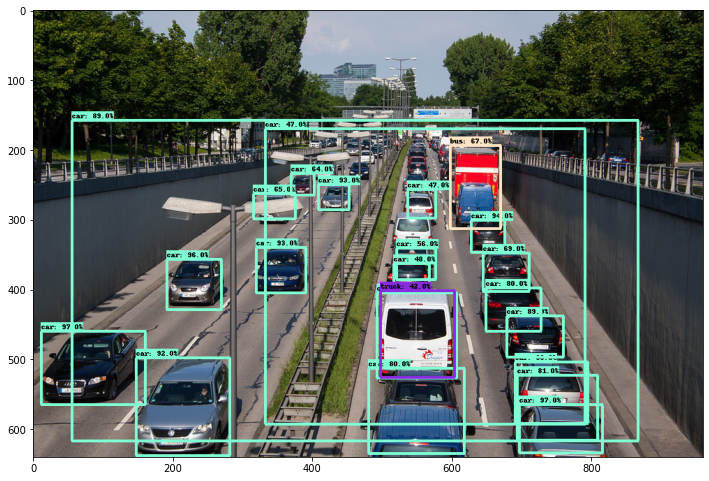

In [25]:
image_path = os.path.join('traffic' + '.jpg')
#image_np = load_image_into_numpy_array(image_path)
img_data = tf.io.gfile.GFile(image_path, 'rb').read()
image = Image.open(BytesIO(img_data))
(im_width, im_height) = image.size
image_np = np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

input_tensor = np.expand_dims(image_np, 0)
start_time = time.time()
detections = detect_fn(input_tensor)
end_time = time.time()
print(end_time - start_time)

plt.rcParams['figure.figsize'] = [42, 21]
label_id_offset = 1
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.int32),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.40,
      agnostic_mode=False)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()
#plt.subplot(2, 1, i+1)
#plt.imshow(image_np_with_detections)

# FewShot Training
ref: https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/eager_few_shot_od_training_tf2_colab.ipynb

In [ ]:
#upload videos to the Colab

In [ ]:
!ffmpeg -i rlc1-150555-150722.mp4 -ss 00:00:05 -t 00:00:50 -c:v copy cut1.mp4 #the -t option specifies a duration

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [ ]:
!ffprobe -v error -show_entries format=duration -of default=noprint_wrappers=1:nokey=1 ./cut1.mp4 #duration

48.700000


In [ ]:
!mkdir TrafficImages #Cut video to images
!ffmpeg -i ./cut1.mp4 -vf fps=1 ./TrafficImages/sjsu-%d.jpg

mkdir: cannot create directory ‘TrafficImages’: File exists
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --e

In [ ]:
!ls ./TrafficImages

sjsu-10.jpg  sjsu-19.jpg  sjsu-27.jpg  sjsu-35.jpg  sjsu-43.jpg  sjsu-6.jpg
sjsu-11.jpg  sjsu-1.jpg   sjsu-28.jpg  sjsu-36.jpg  sjsu-44.jpg  sjsu-7.jpg
sjsu-12.jpg  sjsu-20.jpg  sjsu-29.jpg  sjsu-37.jpg  sjsu-45.jpg  sjsu-8.jpg
sjsu-13.jpg  sjsu-21.jpg  sjsu-2.jpg   sjsu-38.jpg  sjsu-46.jpg  sjsu-9.jpg
sjsu-14.jpg  sjsu-22.jpg  sjsu-30.jpg  sjsu-39.jpg  sjsu-47.jpg
sjsu-15.jpg  sjsu-23.jpg  sjsu-31.jpg  sjsu-3.jpg   sjsu-48.jpg
sjsu-16.jpg  sjsu-24.jpg  sjsu-32.jpg  sjsu-40.jpg  sjsu-49.jpg
sjsu-17.jpg  sjsu-25.jpg  sjsu-33.jpg  sjsu-41.jpg  sjsu-4.jpg
sjsu-18.jpg  sjsu-26.jpg  sjsu-34.jpg  sjsu-42.jpg  sjsu-5.jpg


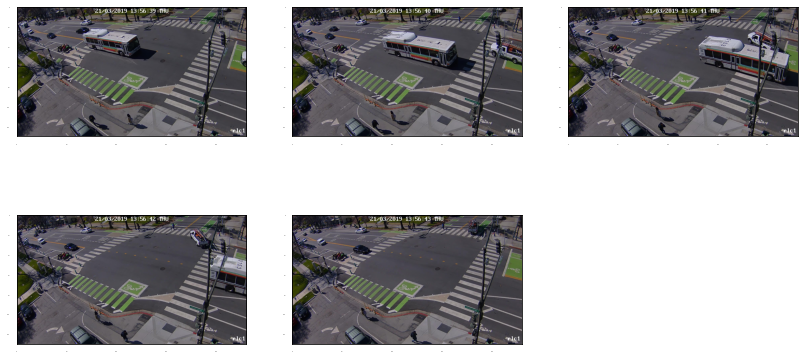

In [ ]:
# Load images and visualize
train_image_dir = './TrafficImages'
train_images_np = []
for i in range(1, 6):
  image_path = os.path.join(train_image_dir, 'sjsu-' + str(i) + '.jpg')
  train_images_np.append(load_image_into_numpy_array(image_path))

plt.rcParams['axes.grid'] = False
plt.rcParams['xtick.labelsize'] = False
plt.rcParams['ytick.labelsize'] = False
plt.rcParams['xtick.top'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.right'] = False
plt.rcParams['figure.figsize'] = [14, 7]

for idx, train_image_np in enumerate(train_images_np):
  plt.subplot(2, 3, idx+1)
  plt.imshow(train_image_np)
plt.show()

In [ ]:
gt_boxes = []
colab_utils.annotate(train_images_np, box_storage_pointer=gt_boxes)

<IPython.core.display.Javascript object>

# Custom Training

In [26]:
from google.colab import auth
auth.authenticate_user()

In [27]:
!gcloud config set project 'cmpelkk'

Updated property [core/project].


In [28]:
!gsutil ls gs://waymodataset #cocodata-bucket

gs://waymodataset/TFRecordTrain--00000-of-00005.tfrecord
gs://waymodataset/TFRecordTrain--00001-of-00005.tfrecord
gs://waymodataset/TFRecordTrain--00002-of-00005.tfrecord
gs://waymodataset/TFRecordTrain--00003-of-00005.tfrecord
gs://waymodataset/TFRecordTrain--00004-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00000-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00001-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00002-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00003-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00004-of-00005.tfrecord
gs://waymodataset/exported-models.zip
gs://waymodataset/json_TFRecordTrain-.json
gs://waymodataset/json_TFRecordVal-.json
gs://waymodataset/waymo_labelmap.txt
gs://waymodataset/Validation0000/
gs://waymodataset/myoutputmodel/


## Check the TFRecord file

Ref: https://github.com/tensorflow/models/blob/6c63efed800ecd5f6168f17c706f35f07f27928b/official/nlp/transformer/data_pipeline.py#L193

In [ ]:
!mkdir tfrecords
!gsutil cp gs://waymodataset/TFRecordTrain--00000-of-00005.tfrecord ./tfrecords

Copying gs://waymodataset/TFRecordTrain--00000-of-00005.tfrecord...
/ [1 files][147.2 MiB/147.2 MiB]                                                
Operation completed over 1 objects/147.2 MiB.                                    


In [ ]:
!ls ./tfrecords

TFRecordTrain--00000-of-00005.tfrecord


In [ ]:
Local_Train_Path='./tfrecords/TFRecordTrain*'
train_filenames = tf.io.gfile.glob(Local_Train_Path)

from official.vision.detection.dataloader import input_reader: https://github.com/tensorflow/models/blob/master/official/vision/detection/main.py https://github.com/tensorflow/models/blob/master/official/vision/detection/dataloader/input_reader.py

In [ ]:
#ref: https://github.com/tensorflow/models/blob/master/official/vision/detection/dataloader/tf_example_decoder.py
def _decode_image(parsed_tensors):
    """Decodes the image and set its static shape."""
    image = tf.io.decode_image(parsed_tensors['image/encoded'], channels=3)
    image.set_shape([None, None, 3])
    return image

def _decode_boxes(parsed_tensors):
    """Concat box coordinates in the format of [ymin, xmin, ymax, xmax]."""
    xmin = parsed_tensors['image/object/bbox/xmin']
    xmax = parsed_tensors['image/object/bbox/xmax']
    ymin = parsed_tensors['image/object/bbox/ymin']
    ymax = parsed_tensors['image/object/bbox/ymax']
    print(ymax)

    return tf.stack([ymin, xmin, ymax, xmax], axis=-1)

def _decode_areas(parsed_tensors):
    xmin = parsed_tensors['image/object/bbox/xmin']
    xmax = parsed_tensors['image/object/bbox/xmax']
    ymin = parsed_tensors['image/object/bbox/ymin']
    ymax = parsed_tensors['image/object/bbox/ymax']
    return tf.cond(
        tf.greater(tf.shape(parsed_tensors['image/object/area'])[0], 0),
        lambda: parsed_tensors['image/object/area'],
        lambda: (xmax - xmin) * (ymax - ymin))

def read_tfrecord(example):
    features = {
        'image/encoded':
            tf.io.FixedLenFeature((), tf.string),
        'image/source_id':
            tf.io.FixedLenFeature((), tf.string),
        'image/height':
            tf.io.FixedLenFeature((), tf.int64),
        'image/width':
            tf.io.FixedLenFeature((), tf.int64),
        'image/object/bbox/xmin':
            tf.io.VarLenFeature(tf.float32),
        'image/object/bbox/xmax':
            tf.io.VarLenFeature(tf.float32),
        'image/object/bbox/ymin':
            tf.io.VarLenFeature(tf.float32),
        'image/object/bbox/ymax':
            tf.io.VarLenFeature(tf.float32),
        'image/object/class/label':
            tf.io.VarLenFeature(tf.int64),
        'image/object/area':
            tf.io.VarLenFeature(tf.float32),
        'image/object/is_crowd':
            tf.io.VarLenFeature(tf.int64),
    }
    # features = {
    #     "image": tf.io.FixedLenFeature([], tf.string), # tf.string means bytestring
    #     "class": tf.io.FixedLenFeature([], tf.int64),  # shape [] means scalar
    # }
    example = tf.io.parse_single_example(example, features)

    for k in example:
      if isinstance(example[k], tf.SparseTensor):
        if example[k].dtype == tf.string:
          example[k] = tf.sparse.to_dense(
              example[k], default_value='')
        else:
          example[k] = tf.sparse.to_dense(
              example[k], default_value=0)
          
    print("Got example")
    print(example['image/object/bbox/xmin'])
    image = _decode_image(example)
    print("Decoded image")
    boxes = _decode_boxes(example)
    print("Decoded boxes:", boxes)
    areas = _decode_areas(example)
    is_crowds = tf.cond(
        tf.greater(tf.shape(example['image/object/is_crowd'])[0], 0),
        lambda: tf.cast(example['image/object/is_crowd'], dtype=tf.bool),
        lambda: tf.zeros_like(example['image/object/class/label'], dtype=tf.bool))  # pylint: disable=line-too-long

    source_id = example['image/source_id']
    height=example['image/height']
    width=example['image/width']
    groundtruth_class=example['image/object/class/label']

    #image = tf.image.decode_jpeg(example['image'], channels=3)
    image = tf.cast(image, tf.float32) / 255.0  # convert image to floats in [0, 1] range
    image = tf.image.resize(image, IMAGE_SIZE)
    #image = tf.reshape(image, [*IMAGE_SIZE, 3]) # explicit size will be needed for TPU
    #class_label = example['class']
    print(groundtruth_class)
    decoded_tensors = {
        'image': image,
        'source_id': source_id,
        'height':height,
        'width':width,
        'groundtruth_classes': groundtruth_class,
        'groundtruth_is_crowd': is_crowds,
        'groundtruth_area': areas,
        'groundtruth_boxes': boxes,
    }
    return decoded_tensors#image, class_label

def load_dataset(filenames):
  # read from TFRecords. For optimal performance, read from multiple
  # TFRecord files at once and set the option experimental_deterministic = False
  # to allow order-altering optimizations.

  option_no_order = tf.data.Options()
  option_no_order.experimental_deterministic = False

  dataset = tf.data.TFRecordDataset(filenames, num_parallel_reads=AUTO)
  dataset = dataset.with_options(option_no_order)
  dataset = dataset.map(read_tfrecord, num_parallel_calls=AUTO)
  return dataset

In [ ]:
AUTO = tf.data.experimental.AUTOTUNE
IMAGE_SIZE = [640, 640] #[192, 192]
display_dataset=load_dataset(train_filenames)

Got example
Tensor("SparseToDense_2:0", shape=(None,), dtype=float32)
Decoded image
Tensor("SparseToDense_3:0", shape=(None,), dtype=float32)
Decoded boxes: Tensor("stack:0", shape=(None, 4), dtype=float32)
Tensor("SparseToDense_5:0", shape=(None,), dtype=int64)


In [ ]:
decoded_tensors =next(iter(display_dataset))
decoded_tensors

{'groundtruth_area': <tf.Tensor: shape=(28,), dtype=float32, numpy=
 array([1.3813018e-04, 7.1024448e-02, 3.1164298e-05, 1.1053344e-01,
        8.5865184e-05, 3.4345756e-04, 2.8014310e-02, 4.2039723e-04,
        5.9358717e-04, 2.2156033e-04, 2.0308865e-03, 3.4995115e-04,
        2.3373224e-05, 2.8911594e-03, 4.2510359e-03, 2.4266035e-04,
        1.0453107e-04, 5.8719148e-03, 3.8548259e-03, 2.6587278e-04,
        4.3873844e-04, 6.7198554e-05, 1.5403732e-03, 1.4543472e-04,
        2.7187803e-04, 3.6131436e-04, 6.5161418e-03, 2.1019815e-04],
       dtype=float32)>,
 'groundtruth_boxes': <tf.Tensor: shape=(28, 4), dtype=float32, numpy=
 array([[0.520815  , 0.37155256, 0.5390719 , 0.37911847],
        [0.6636629 , 0.78882957, 1.        , 1.        ],
        [0.5097129 , 0.44408673, 0.515634  , 0.44934997],
        [0.59260905, 0.3796119 , 0.98241854, 0.6631695 ],
        [0.51292014, 0.39655298, 0.52426904, 0.40411893],
        [0.5277231 , 0.2865182 , 0.5390719 , 0.31678185],
        [0.5

In [ ]:
decoded_tensors['groundtruth_boxes'].numpy()

array([[0.520815  , 0.37155256, 0.5390719 , 0.37911847],
       [0.6636629 , 0.78882957, 1.        , 1.        ],
       [0.5097129 , 0.44408673, 0.515634  , 0.44934997],
       [0.59260905, 0.3796119 , 0.98241854, 0.6631695 ],
       [0.51292014, 0.39655298, 0.52426904, 0.40411893],
       [0.5277231 , 0.2865182 , 0.5390719 , 0.31678185],
       [0.5274763 , 0.46546867, 0.6597155 , 0.67731446],
       [0.5168676 , 0.30230793, 0.53413767, 0.32665044],
       [0.53068364, 0.26760337, 0.5568354 , 0.29030114],
       [0.5282165 , 0.3136568 , 0.5385785 , 0.33503875],
       [0.5368515 , 0.17368725, 0.582247  , 0.21842487],
       [0.5136603 , 0.37648684, 0.5353712 , 0.39260554],
       [0.5084793 , 0.45724484, 0.51292014, 0.46250808],
       [0.5284632 , 0.3171108 , 0.5886616 , 0.36513796],
       [0.5708982 , 0.        , 0.66662353, 0.04440867],
       [0.5198282 , 0.3320782 , 0.53117704, 0.35346013],
       [0.513907  , 0.48619273, 0.5252559 , 0.4954034 ],
       [0.5348778 , 0.07039597,

In [ ]:
decoded_tensors['width'].numpy()

1920

In [ ]:
testimage=decoded_tensors['image']
testlabel=decoded_tensors['groundtruth_classes'].numpy()
testboundingbox=decoded_tensors['groundtruth_boxes'].numpy()
testlabel.size

28

In [ ]:
testboundingbox.shape

(28, 4)

In [ ]:
[xmin, ymin, xmax, ymax]=testboundingbox[0]

In [ ]:
testboundingbox[0]*192

array([ 99.99648,  71.33809, 103.50181,  72.79075], dtype=float32)

In [ ]:
xmin

0.520815

In [ ]:
IMAGE_SIZE[0]

192

In [ ]:
INSTANCE_CATEGORY_NAMES[1]

'Vehicles'

28
[0.520815   0.37155256 0.5390719  0.37911847]
Class id: 1
[0.6636629  0.78882957 1.         1.        ]
Class id: 1
[0.5097129  0.44408673 0.515634   0.44934997]
Class id: 1
[0.59260905 0.3796119  0.98241854 0.6631695 ]
Class id: 1
[0.51292014 0.39655298 0.52426904 0.40411893]
Class id: 1
[0.5277231  0.2865182  0.5390719  0.31678185]
Class id: 1
[0.5274763  0.46546867 0.6597155  0.67731446]
Class id: 1
[0.5168676  0.30230793 0.53413767 0.32665044]
Class id: 1
[0.53068364 0.26760337 0.5568354  0.29030114]
Class id: 1
[0.5282165  0.3136568  0.5385785  0.33503875]
Class id: 1
[0.5368515  0.17368725 0.582247   0.21842487]
Class id: 1
[0.5136603  0.37648684 0.5353712  0.39260554]
Class id: 1
[0.5084793  0.45724484 0.51292014 0.46250808]
Class id: 1
[0.5284632  0.3171108  0.5886616  0.36513796]
Class id: 1
[0.5708982  0.         0.66662353 0.04440867]
Class id: 1
[0.5198282  0.3320782  0.53117704 0.35346013]
Class id: 1
[0.513907   0.48619273 0.5252559  0.4954034 ]
Class id: 1
[0.5348778 

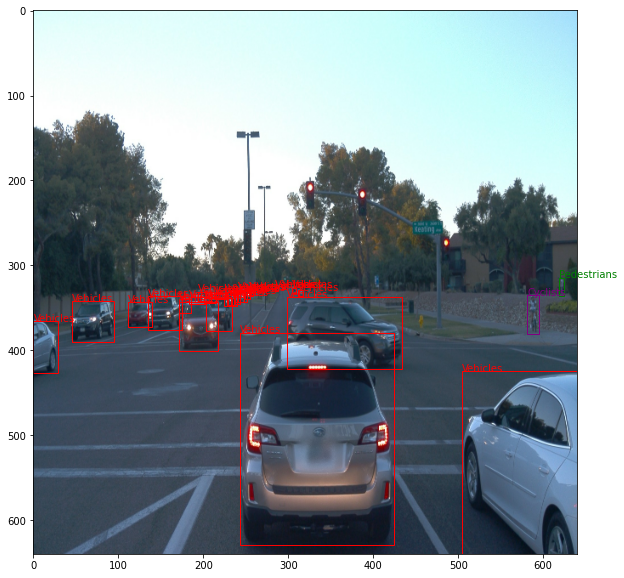

In [ ]:
import pandas as pd
import os, sys, math
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.patches as patches

##Unknown:0, Vehicles: 1, Pedestrians: 2, Cyclists: 3, Signs (removed)
INSTANCE_CATEGORY_NAMES = [
    'Unknown', 'Vehicles', 'Pedestrians', 'Cyclists'
]
INSTANCE_Color = {
    'Unknown':'black', 'Vehicles':'red', 'Pedestrians':'green', 'Cyclists':'purple'
}#'Unknown', 'Vehicles', 'Pedestrians', 'Cyclists'


def show_oneimage_category(image, label, boundingbox):
  fig = plt.figure(figsize=(10,10))
  ax = fig.add_subplot(1, 1, 1)

  len=label.size
  print(len)
  for index in range(len):
    box= boundingbox[index]
    print(box)
    labelid=label[index]
    labelname=INSTANCE_CATEGORY_NAMES[labelid]
    print("Class id:", labelid)
    classcolor=INSTANCE_Color[labelname]
    [xmin, ymin, xmax, ymax]=box*IMAGE_SIZE[0]
    # Draw the object bounding box.
    ax.add_patch(patches.Rectangle(
        xy=(ymin,
            xmin),
        width=ymax-ymin,
        height=xmax-xmin,
        linewidth=1,
        edgecolor=classcolor, #'red',
        facecolor='none'))
    ax.text(ymin, xmin, labelname, color=classcolor, fontsize=10)
            
  
  plt.imshow(image)
  #plt.title(CLASSES[label_batch.numpy()])

testimage=decoded_tensors['image']
testlabel=decoded_tensors['groundtruth_classes'].numpy()
testboundingbox=decoded_tensors['groundtruth_boxes'].numpy()
show_oneimage_category(testimage, testlabel, testboundingbox)

## Start Custom Training

In [30]:
AUTO = tf.data.experimental.AUTOTUNE
GCS_Train_PATTERN = 'gs://cocodata-bucket/TFRecords-Train*' 
IMAGE_SIZE = [640, 640] #[192, 192]

BATCH_SIZE = 64 # 128 works on GPU too but comes very close to the memory limit of the Colab GPU
EPOCHS = 10

In [31]:
!mkdir myoutputmodel

In [ ]:
#Download the model
#!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/centernet_hg104_1024x1024_coco17_tpu-32.tar.gz
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
#https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md

--2020-09-13 23:49:24--  http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 108.177.126.128, 2a00:1450:4013:c01::80
Connecting to download.tensorflow.org (download.tensorflow.org)|108.177.126.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 211996178 (202M) [application/x-tar]
Saving to: ‘faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz’

faster_rcnn_resnet5 100%[===================>] 202.17M  56.6MB/s    in 3.6s    

2020-09-13 23:49:28 (56.6 MB/s) - ‘faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz’ saved [211996178/211996178]



In [ ]:
!tar -xf faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz

In [33]:
!gsutil ls gs://waymodataset/

gs://waymodataset/TFRecordTrain--00000-of-00005.tfrecord
gs://waymodataset/TFRecordTrain--00001-of-00005.tfrecord
gs://waymodataset/TFRecordTrain--00002-of-00005.tfrecord
gs://waymodataset/TFRecordTrain--00003-of-00005.tfrecord
gs://waymodataset/TFRecordTrain--00004-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00000-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00001-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00002-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00003-of-00005.tfrecord
gs://waymodataset/TFRecordVal--00004-of-00005.tfrecord
gs://waymodataset/exported-models.zip
gs://waymodataset/json_TFRecordTrain-.json
gs://waymodataset/json_TFRecordVal-.json
gs://waymodataset/waymo_labelmap.txt
gs://waymodataset/Validation0000/
gs://waymodataset/myoutputmodel/


In [34]:
#Copy the labelmap to local, you need to create this labelmap file for your own dataset
!gsutil cp gs://waymodataset/waymo_labelmap.txt ./

Copying gs://waymodataset/waymo_labelmap.txt...
/ [1 files][  114.0 B/  114.0 B]                                                
Operation completed over 1 objects/114.0 B.                                      


In [35]:
!cat waymo_labelmap.txt


item {
  id: 1
  name: 'Vehicles'
}

item {
  id: 2
  name: 'Pedestrians'
}

item {
  id: 3
  name: 'Cyclists'
}


In [36]:
#You can put multiple models into the MODELS_CONFIG and select the model you need
MODELS_CONFIG = {
    'fasterrcnnresnet50_640': {
        'model_name': 'faster_rcnn_resnet50_v1_640x640_coco17_tpu-8',
        'base_pipeline_file': 'faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.config',
        'pretrained_checkpoint': 'faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz',
        'batch_size':4
    }
}

chosen_model = 'fasterrcnnresnet50_640'

num_steps = 40000 #The more steps, the longer the training. Increase if your loss function is still decreasing and validation metrics are increasing. 
num_eval_steps = 500 #Perform evaluation after so many steps


model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']
batch_size = MODELS_CONFIG[chosen_model]['batch_size']

In [37]:
pipeline_fname = './'+ model_name + '/pipeline.config' # + base_pipeline_file
fine_tune_checkpoint = './' + model_name + '/checkpoint/ckpt-0'
label_map_pbtxt_fname = './waymo_labelmap.txt'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)
num_classes

3

In [38]:
test_record_fname = "gs://waymodataset/TFRecordTrain*"#"./tfrecords/TFRecords-Train*"
train_record_fname = "gs://waymodataset/TFRecordVal*"#./tfrecords/TFRecords-Val*"

In [39]:
pipeline_fname #modify this config file to perform custom training

'./faster_rcnn_resnet50_v1_640x640_coco17_tpu-8/pipeline.config'

Configure the pipeline.config in the model directory to perform custom training:


1.   change num_classes
2.   change batch_size
3.   label_map_path
4.   train input tfrecord
5.   val input tfrecord



In [42]:
#write custom configuration file by slotting our dataset, model checkpoint, and training parameters into the base pipeline file

import re
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:
    
    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size. Bug: changes the train and evaluation batch_size. If the evaluation batch_size is not 1, the evaluation process cannot be run
    # s = re.sub('batch_size: [0-9]+',
    #            'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    
    #fine-tune checkpoint type, change from classification to detection
    #By setting it to detection essentially you can restore almost all variables from the checkpoint, and by setting it to classification, only variables from the feature_extractor scope are restored
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)
        
    f.write(s)



writing custom configuration file


manually change the training batch_size in the pipeline_file.config

If you want to freeze all the backbone and only updating the weights for the box predictor, you can set *freeze_variables: "feature_extractor"* after the fine_tune_checkpoint, so that all variables that have feature_extractor in their names won't be updated. ref: https://stackoverflow.com/questions/56012092/tensorflow-object-detection-api-how-does-the-fine-tuning-of-a-model-works

In [44]:
PIPELINE_CONFIG_PATH='./pipeline_file.config'
MODEL_DIR='./myoutputmodel'
!python models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --alsologtostderr

2020-10-20 19:03:08.414305: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-20 19:03:10.555860: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-10-20 19:03:10.561920: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-10-20 19:03:10.562455: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 15.75GiB deviceMemoryBandwidth: 836.37GiB/s
2020-10-20 19:03:10.562492: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-20 19:03:10.564179: I tensorflow/stream_executor/plat

In [45]:
!ls myoutputmodel

checkpoint		     ckpt-38.index
ckpt-35.data-00000-of-00001  ckpt-39.data-00000-of-00001
ckpt-35.index		     ckpt-39.index
ckpt-36.data-00000-of-00001  ckpt-40.data-00000-of-00001
ckpt-36.index		     ckpt-40.index
ckpt-37.data-00000-of-00001  ckpt-41.data-00000-of-00001
ckpt-37.index		     ckpt-41.index
ckpt-38.data-00000-of-00001  train


In [46]:
PIPELINE_CONFIG_PATH='./pipeline_file.config'
MODEL_DIR='./myoutputmodel' #'/content/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8'
CHECKPOINT_DIR='./myoutputmodel'
!python models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --checkpoint_dir={CHECKPOINT_DIR} \
    --alsologtostderr

2020-10-20 23:26:36.237699: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
W1020 23:26:41.360049 140381122533248 model_lib_v2.py:925] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1020 23:26:41.360273 140381122533248 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1020 23:26:41.360357 140381122533248 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1020 23:26:41.360433 140381122533248 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W1020 23:26:41.360546 140381122533248 model_lib_v2.py:940] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2020-10-20 23:26:41.405762: I tensorflow/stream_executor/pl

In [47]:
!python models/research/object_detection/exporter_main_v2.py --input_type image_tensor --pipeline_config_path {PIPELINE_CONFIG_PATH} --trained_checkpoint_dir ./myoutputmodel --output_directory ./Newexported-models

!zip Newexported-models_fasterrcnn.zip -r ./Newexported-models
from google.colab import files
files.download('Newexported-models_fasterrcnn.zip')

2020-10-21 00:32:28.965020: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-21 00:32:31.103715: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-10-21 00:32:31.109776: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-10-21 00:32:31.110351: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 15.75GiB deviceMemoryBandwidth: 836.37GiB/s
2020-10-21 00:32:31.110395: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-21 00:32:31.112202: I tensorflow/stream_executor/plat

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [48]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [49]:
%tensorboard --logdir ./myoutputmodel/

Output hidden; open in https://colab.research.google.com to view.

In [50]:
from tensorboard import notebook
notebook.list() # View open TensorBoard instances

Known TensorBoard instances:
  - port 6006: logdir ./myoutputmodel/ (started 0:01:02 ago; pid 33612)


## Continue training without freeze backbone

In [51]:
PIPELINE_CONFIG_PATH='./pipeline_file.config' #remove freeze_variables: "feature_extractor"
#change num_steps: 80000
MODEL_DIR='./myoutputmodel'
!python models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --alsologtostderr

#Evaluation
CHECKPOINT_DIR=MODEL_DIR #'./myoutputmodel'
!python models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --checkpoint_dir={CHECKPOINT_DIR} \
    --alsologtostderr

#Export saved model
!python models/research/object_detection/exporter_main_v2.py --input_type image_tensor --pipeline_config_path {PIPELINE_CONFIG_PATH} --trained_checkpoint_dir ./myoutputmodel --output_directory ./Newexported-models2

#Download
!zip Newexported-models_fasterrcnn2.zip -r ./Newexported-models2
from google.colab import files
files.download('Newexported-models_fasterrcnn2.zip')

2020-10-21 02:37:21.507889: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-21 02:37:24.047234: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-10-21 02:37:24.054083: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-10-21 02:37:24.054654: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 15.75GiB deviceMemoryBandwidth: 836.37GiB/s
2020-10-21 02:37:24.054697: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-21 02:37:24.057196: I tensorflow/stream_executor/plat

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Start a new training without freeze the backbone

In [52]:
PIPELINE_CONFIG_PATH='./pipeline_file.config' #remove freeze_variables: "feature_extractor"
#change num_steps: 80000
MODEL_DIR='./myoutputmodel2' #choose a different model output folder
!python models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --alsologtostderr

#Evaluation
CHECKPOINT_DIR=MODEL_DIR
!python models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --checkpoint_dir={CHECKPOINT_DIR} \
    --alsologtostderr

#Export saved model
!python models/research/object_detection/exporter_main_v2.py --input_type image_tensor --pipeline_config_path {PIPELINE_CONFIG_PATH} --trained_checkpoint_dir ./myoutputmodel2 --output_directory ./Newexported-models3

#Download
!zip Newexported-models_fasterrcnn3.zip -r ./Newexported-models3
from google.colab import files
files.download('Newexported-models_fasterrcnn3.zip')

2020-10-21 07:32:16.003785: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-21 07:32:18.333276: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-10-21 07:32:18.339414: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-10-21 07:32:18.339971: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 15.75GiB deviceMemoryBandwidth: 836.37GiB/s
2020-10-21 07:32:18.340012: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-21 07:32:18.341833: I tensorflow/stream_executor/plat

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Test inference based on trained model

In [53]:
import time
start_time = time.time()
tf.keras.backend.clear_session()
detect_fn = tf.saved_model.load('./Newexported-models/saved_model/')
end_time = time.time()
elapsed_time = end_time - start_time
print('Elapsed time: ' + str(elapsed_time) + 's')

Elapsed time: 10.329437732696533s


In [54]:
label_map_path='./waymo_labelmap.txt'
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

1.3305859565734863


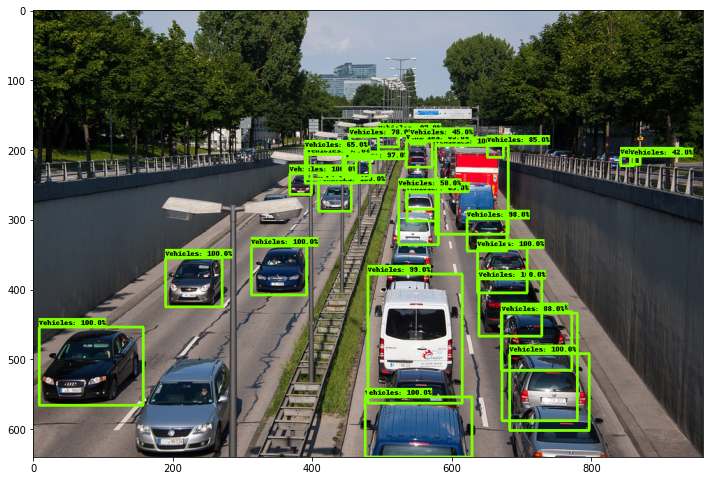

In [55]:
image_path = os.path.join('traffic' + '.jpg')
#image_np = load_image_into_numpy_array(image_path)
img_data = tf.io.gfile.GFile(image_path, 'rb').read()
image = Image.open(BytesIO(img_data))
(im_width, im_height) = image.size
image_np = np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

input_tensor = np.expand_dims(image_np, 0)
start_time = time.time()
detections = detect_fn(input_tensor)
end_time = time.time()
print(end_time - start_time)

plt.rcParams['figure.figsize'] = [42, 21]
label_id_offset = 1
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.int32),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.40,
      agnostic_mode=False)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

In [56]:
# From the tensorflow/models/research/ directory
!cd models/research/ && python object_detection/export_tflite_graph_tf2.py \
    --pipeline_config_path /content/pipeline_file.config \
    --trained_checkpoint_dir /content/myoutputmodel/ \
    --output_directory /content/exported_model_tflite

2020-10-21 17:53:21.129958: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Traceback (most recent call last):
  File "object_detection/export_tflite_graph_tf2.py", line 126, in <module>
    app.run(main)
  File "/usr/local/lib/python3.6/dist-packages/absl/app.py", line 300, in run
    _run_main(main, args)
  File "/usr/local/lib/python3.6/dist-packages/absl/app.py", line 251, in _run_main
    sys.exit(main(argv))
  File "object_detection/export_tflite_graph_tf2.py", line 122, in main
    FLAGS.ssd_use_regular_nms)
  File "/usr/local/lib/python3.6/dist-packages/object_detection/export_tflite_graph_lib_tf2.py", line 229, in export_tflite_model
    pipeline_config.model.WhichOneof('model')))
ValueError: Only ssd models are supported in tflite. Found faster_rcnn in config


# Video Data

In [57]:
!pip install pytube3 #https://pypi.org/project/pytube3/

In [59]:
#!pip3 install pytube --user
import pytube
video_url = 'https://www.youtube.com/watch?v=_i4qgq2rzRs'#'https://www.youtube.com/watch?v=gY8E8ILFkzo'
youtube = pytube.YouTube(video_url)
video = youtube.streams.first()

In [60]:
!pwd
!mkdir videos

/content


In [61]:
video.download('videos/')

'/content/videos/Driving in San Jose 4K - Silicon Valley - California USA.mp4'

In [62]:
!mv ./videos/*.mp4 testvideo1.mp4

In [63]:
import os
import pathlib
import cv2
import time
#!apt install python3-opencv
print(cv2.__version__)

4.4.0


In [64]:
!pip install --upgrade imutils

Requirement already up-to-date: imutils in /usr/local/lib/python3.6/dist-packages (0.5.3)


In [65]:
from imutils.video import FPS
import imutils

In [66]:
!ffmpeg -i testvideo1.mp4 -t 00:00:30 -c:v copy video-clip1.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [67]:
import time
start_time = time.time()
tf.keras.backend.clear_session()
detect_fn = tf.saved_model.load('./Newexported-models3/saved_model/')
end_time = time.time()
elapsed_time = end_time - start_time
print('Elapsed time: ' + str(elapsed_time) + 's')

Elapsed time: 7.510227680206299s


In [68]:
label_map_path='./waymo_labelmap.txt'
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

In [69]:
import cv2
video_path='./video-clip1.mp4'#'./testvideo1.mp4'
cap = cv2.VideoCapture(video_path)
print(cap.get(cv2.CAP_PROP_FPS))
# We convert the resolutions from float to integer.
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
print(frame_width)
print(frame_height)

30.0
640
360


In [70]:
fps = FPS().start()

# Define the codec and create VideoWriter object.
#out = cv2.VideoWriter('./output_video2.mp4',cv2.VideoWriter_fourcc('M','J','P','G'), 10, (frame_width,frame_height))
out = cv2.VideoWriter('./output_video1.mp4',cv2.VideoWriter_fourcc('M','P','4','V'), 30, (frame_width,frame_height))

i=0

# frame 
currentframe = 0
while (cap.isOpened() and currentframe<2000):
  ret, image_np = cap.read()
  if len((np.array(image_np)).shape) == 0:
    break
  
  input_tensor = np.expand_dims(image_np, 0)
  start_time = time.time()
  detections = detect_fn(input_tensor)
  end_time = time.time()
  print(end_time - start_time)

  plt.rcParams['figure.figsize'] = [42, 21]
  label_id_offset = 1
  image_np_with_detections = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'][0].numpy(),
        detections['detection_classes'][0].numpy().astype(np.int32),
        detections['detection_scores'][0].numpy(),
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=.40,
        agnostic_mode=False)

  #display(Image.fromarray(image_np))
  #cv2_imshow('object detection', cv2.resize(image_np, (800,600)))
  #cv2_imshow(cv2.resize(image_np, (640,360)))
  name = './Test_data/frame' + str(currentframe) + '.jpg'
  #print ('Creating\...' + name) 
  #Optional: write images to local folder
  #cv2.imwrite(name, image_np_with_detections) 
  # increasing counter so that it will 
            # show how many frames are created 
  currentframe += 1
  fps.update()
  out.write(image_np_with_detections)

# stop the timer and display FPS information
fps.stop()
print("[INFO] elasped time: {:.2f}".format(fps.elapsed()))
print("[INFO] approx. FPS: {:.2f}".format(fps.fps()))
cap.release()
out.release()
#cv2.destroyAllWindows()

1.4398469924926758
0.044052839279174805
0.04367876052856445
0.04281449317932129
0.04557967185974121
0.04416918754577637
0.041751861572265625
0.041651010513305664
0.04599165916442871
0.04210662841796875
0.04115414619445801
0.041448354721069336
0.045691728591918945
0.044275760650634766
0.041425466537475586
0.04184222221374512
0.04141974449157715
0.0422818660736084
0.04183340072631836
0.041231632232666016
0.041805267333984375
0.04338359832763672
0.041085004806518555
0.04146885871887207
0.04487299919128418
0.041805267333984375
0.041704416275024414
0.04158353805541992
0.04046058654785156
0.040926456451416016
0.04201197624206543
0.04245138168334961
0.0437169075012207
0.04471111297607422
0.04076027870178223
0.04120039939880371
0.04142332077026367
0.04147005081176758
0.04163169860839844
0.04077339172363281
0.04164385795593262
0.04087114334106445
0.04323935508728027
0.0419621467590332
0.043953895568847656
0.0410313606262207
0.04125833511352539
0.04102635383605957
0.04251813888549805
0.048056125

In [71]:
from google.colab import files
files.download('output_video1.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>